Importing the libraries and a pre-trained model

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import tensorflow as tf
import cv2
import random
import PIL.Image

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
basemodel = tf.keras.applications.InceptionV3(include_top = False, weights='imagenet')

In [ ]:
basemodel.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

Importing and Merging Images

In [ ]:
from PIL import Image

In [ ]:
img_1 = Image.open('/content/drive/My Drive/Creative AI Dataset/mars.jpg')
img_2 = Image.open('/content/drive/My Drive/Creative AI Dataset/eiffel.jpg')

In [ ]:
img = Image.blend(img_1, img_2, 0.5)
img.save('ImageBlend.jpg')

In [ ]:
samp_img = tf.keras.preprocessing.image.load_img('ImageBlend.jpg')

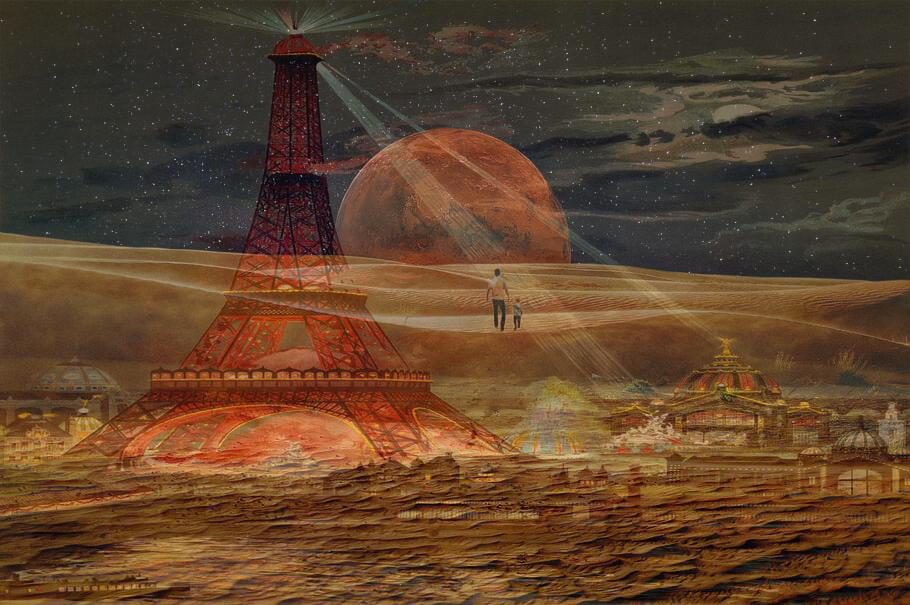

In [ ]:
samp_img

In [ ]:
np.shape(samp_img)

(605, 910, 3)

In [ ]:
type(samp_img)

PIL.JpegImagePlugin.JpegImageFile

In [ ]:
samp_img = tf.keras.preprocessing.image.img_to_array(samp_img)

In [ ]:
type(samp_img)

numpy.ndarray

In [ ]:
samp_img

array([[[ 63.,  56.,  40.],
        [ 62.,  55.,  39.],
        [ 62.,  55.,  39.],
        ...,
        [ 56.,  54.,  42.],
        [ 56.,  54.,  42.],
        [ 56.,  54.,  42.]],

       [[ 61.,  54.,  38.],
        [ 60.,  53.,  37.],
        [ 59.,  52.,  36.],
        ...,
        [ 55.,  53.,  41.],
        [ 55.,  53.,  41.],
        [ 56.,  54.,  42.]],

       [[ 58.,  51.,  35.],
        [ 58.,  51.,  35.],
        [ 57.,  50.,  34.],
        ...,
        [ 52.,  50.,  38.],
        [ 53.,  51.,  39.],
        [ 54.,  52.,  40.]],

       ...,

       [[141., 103.,  41.],
        [141., 103.,  41.],
        [144., 106.,  44.],
        ...,
        [110.,  57.,  23.],
        [105.,  55.,  22.],
        [102.,  53.,  21.]],

       [[128.,  92.,  34.],
        [130.,  94.,  36.],
        [134.,  98.,  40.],
        ...,
        [101.,  50.,  19.],
        [ 99.,  48.,  17.],
        [ 97.,  46.,  15.]],

       [[131.,  95.,  43.],
        [135., 100.,  46.],
        [140., 1

In [ ]:
print('Min Pixel Value : {0: } \nMax Pixel Value : {1: }'.format(samp_img.min(), samp_img.max()))

Min Pixel Value :  0.0 
Max Pixel Value :  255.0


In [ ]:
samp_img = np.array(samp_img)/255.0
samp_img.shape

(605, 910, 3)

In [ ]:
print('Min Pixel Value : {0: } \nMax Pixel Value : {1: }'.format(samp_img.min(), samp_img.max()))

Min Pixel Value :  0.0 
Max Pixel Value :  1.0


In [ ]:
samp_img = tf.expand_dims(samp_img, axis=0)

In [ ]:
np.shape(samp_img)

TensorShape([1, 605, 910, 3])

Run pre-trained model and explore activations

In [ ]:
names = ['mixed3', 'mixed5', 'mixed7']

In [ ]:
layers = [basemodel.get_layer(name).output for name in names]
deepdrm_model = tf.keras.Model(inputs = basemodel.input, outputs = layers)

In [ ]:
deepdrm_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [ ]:
activations = deepdrm_model(samp_img)
activations

[<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
 array([[[[0.        , 0.        , 0.        , ..., 0.02111552,
           0.42713752, 0.3067988 ],
          [0.        , 0.13667183, 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.25661886, 0.        , ..., 0.        ,
           0.07347754, 0.        ],
          ...,
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.        , 0.        , ..., 0.42646825,
           0.        , 0.        ],
          [0.05945545, 0.        , 0.        , ..., 0.42646825,
           0.64126146, 0.        ]],
 
         [[0.67514044, 0.        , 0.        , ..., 0.02111552,
           0.28741157, 0.6544873 ],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.22241183],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          ...,
        

In [ ]:
len(activations)

3

Implement DeepDream : Loss Calculation

In [ ]:
samp_img.shape

TensorShape([1, 605, 910, 3])

In [ ]:
samp_img = tf.squeeze(samp_img, axis = 0)

In [ ]:
samp_img.shape

TensorShape([605, 910, 3])

In [ ]:
def calc_loss(image, model):
  img_batch = tf.expand_dims(image, axis=0) 
  layer_activations = model(img_batch) 
  print('ACTIVATION VALUES (LAYER OUTPUT) =\n', layer_activations)

  losses = [] 
  for act in layer_activations:
    loss = tf.math.reduce_mean(act)  
    losses.append(loss)
  
  print('LOSSES (FROM MULTIPLE ACTIVATION LAYERS) = ', losses)
  print('LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) = ', np.shape(losses))
  print('SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)= ', tf.reduce_sum(losses))

  return  tf.reduce_sum(losses)  

In [ ]:
loss = calc_loss(tf.Variable(samp_img), deepdrm_model)

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
array([[[[0.        , 0.        , 0.        , ..., 0.02111552,
          0.42713752, 0.3067988 ],
         [0.        , 0.13667183, 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.25661886, 0.        , ..., 0.        ,
          0.07347754, 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.42646825,
          0.        , 0.        ],
         [0.05945545, 0.        , 0.        , ..., 0.42646825,
          0.64126146, 0.        ]],

        [[0.67514044, 0.        , 0.        , ..., 0.02111552,
          0.28741157, 0.6544873 ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.22241183],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
       

In [ ]:
loss

<tf.Tensor: shape=(), dtype=float32, numpy=0.5577076>

Implement DeepDream : Gradient Calculation

In [ ]:
@tf.function
def deepdream(model, image, step_size):
    with tf.GradientTape() as tape:
      tape.watch(image)
      loss = calc_loss(image, model) 

    gradients = tape.gradient(loss, image)

    print('GRADIENTS =\n', gradients)
    print('GRADIENTS SHAPE =\n', np.shape(gradients))

    gradients /= tf.math.reduce_std(gradients)  

    image = image + gradients * step_size
    image = tf.clip_by_value(image, -1, 1)

    return loss, image

In [ ]:
def deprocess(image):
  image = 255*(image + 1.0)/2.0
  return tf.cast(image, tf.uint8)

In [ ]:
def run_deep_dream(model, image, steps = 100, step_size = 0.01):
  image = tf.keras.applications.inception_v3.preprocess_input(image)

  for step in range(steps):
    loss, image = deepdream(model, image, step_size)
    
    if step % 100 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print ("Step {}, loss {}".format(step, loss))

  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

In [ ]:
samp_img.shape

TensorShape([605, 910, 3])

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor 'model/mixed3/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed5/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed7/concat:0' shape=(1, 36, 55, 768) dtype=float32>]
LOSSES (FROM MULTIPLE ACTIVATION LAYERS) =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) =  (3,)
SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)=  Tensor("Sum:0", shape=(), dtype=float32)
GRADIENTS =
 Tensor("gradient_tape/Reshape_4:0", shape=(605, 910, 3), dtype=float32)
GRADIENTS SHAPE =
 (605, 910, 3)


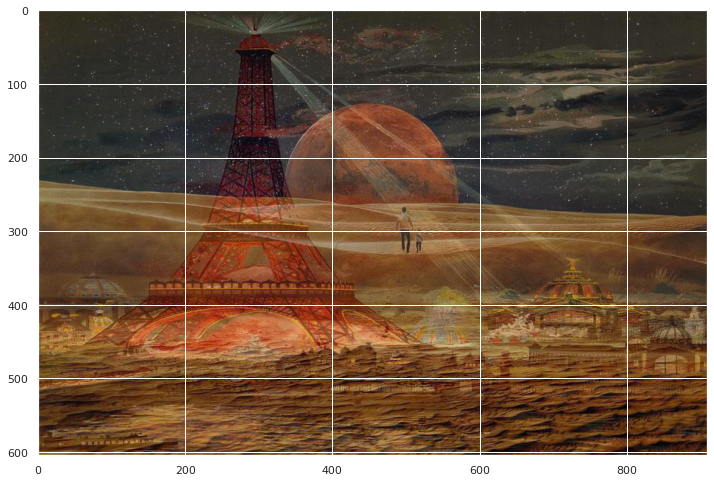

Step 0, loss 0.5804304480552673


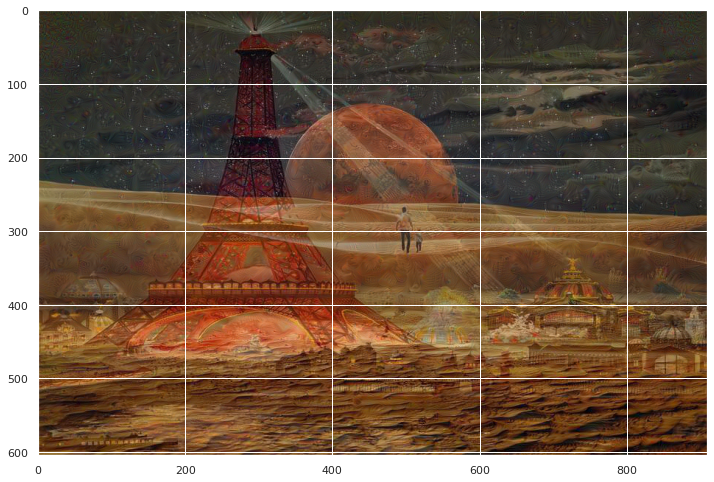

Step 100, loss 1.2805495262145996


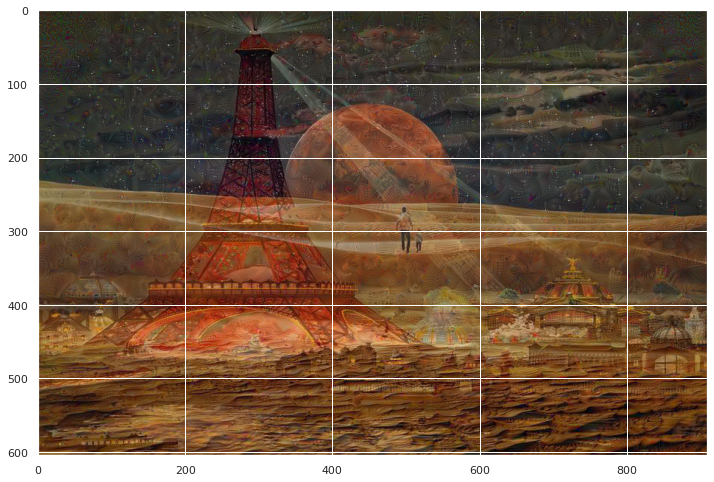

Step 200, loss 1.4971678256988525


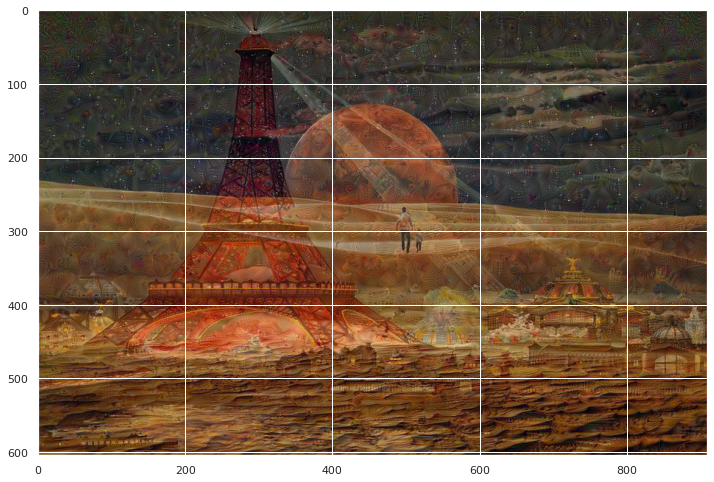

Step 300, loss 1.631124496459961


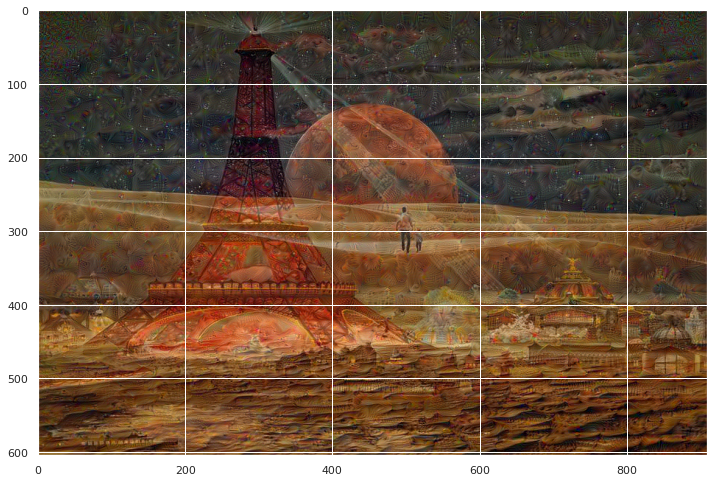

Step 400, loss 1.7302038669586182


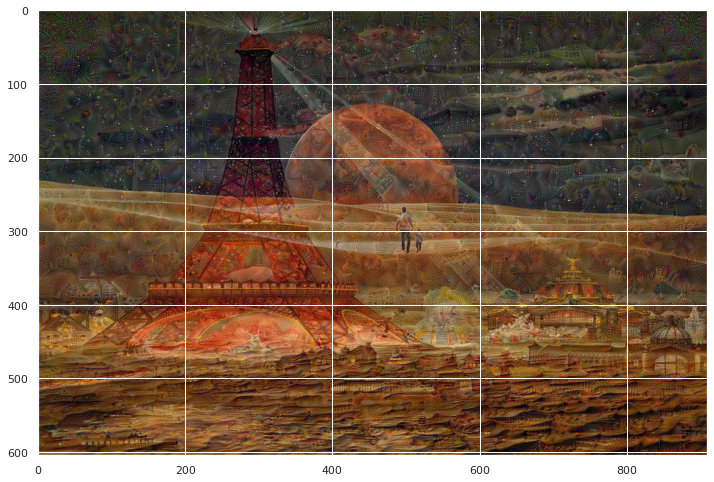

Step 500, loss 1.8116512298583984


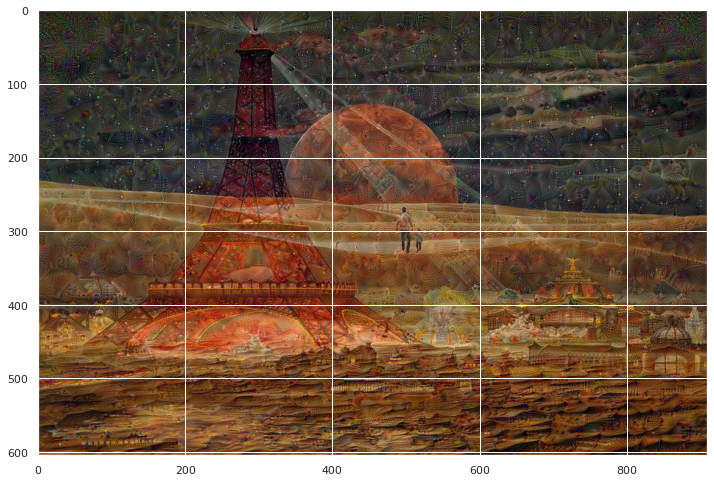

Step 600, loss 1.8804681301116943


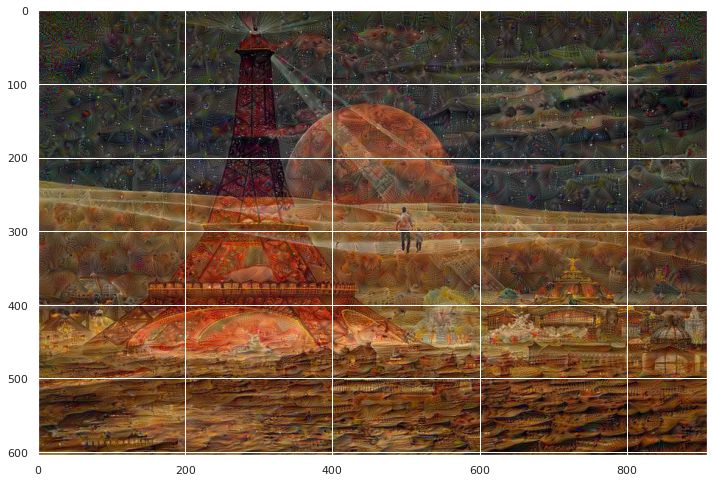

Step 700, loss 1.9411616325378418


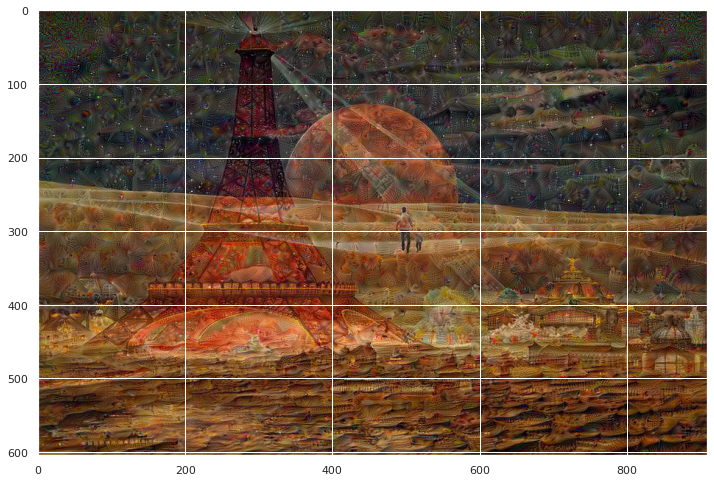

Step 800, loss 1.9944167137145996


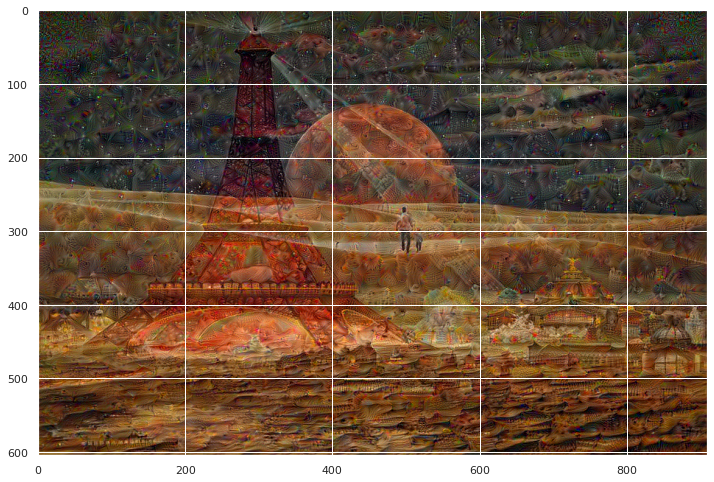

Step 900, loss 2.0419914722442627


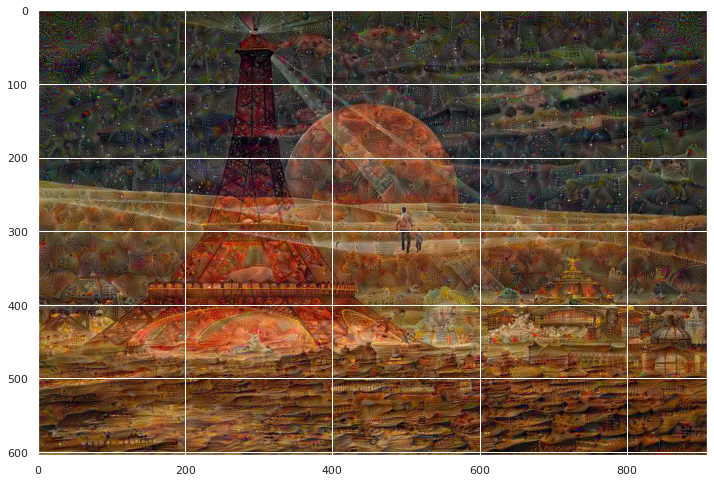

Step 1000, loss 2.085348129272461


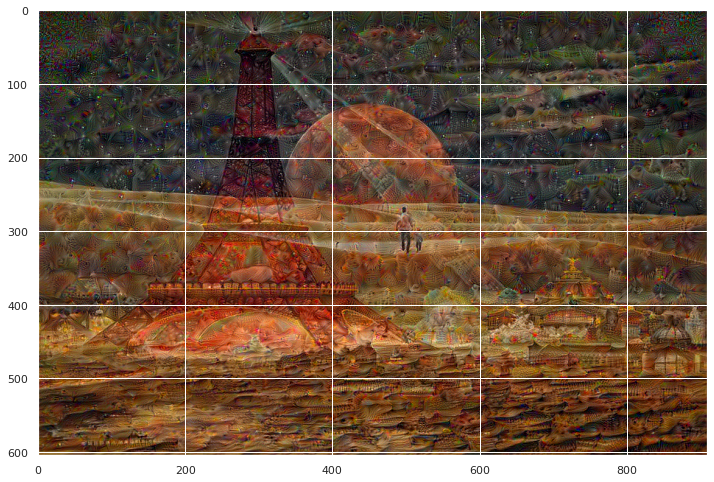

Step 1100, loss 2.125321388244629


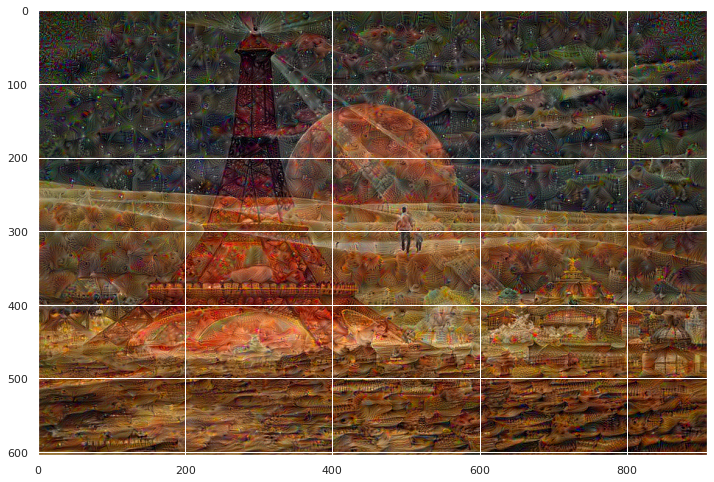

Step 1200, loss 2.162163734436035


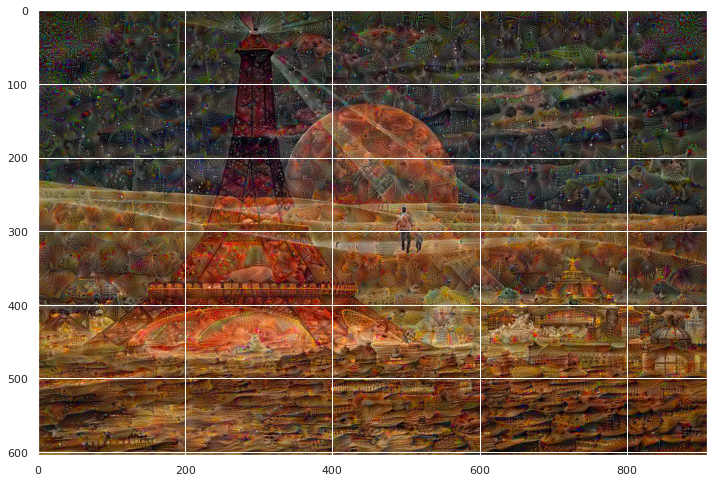

Step 1300, loss 2.1957907676696777


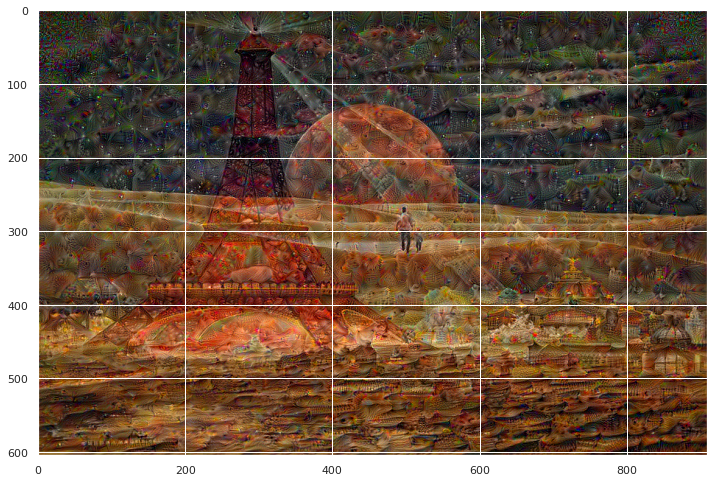

Step 1400, loss 2.227342128753662


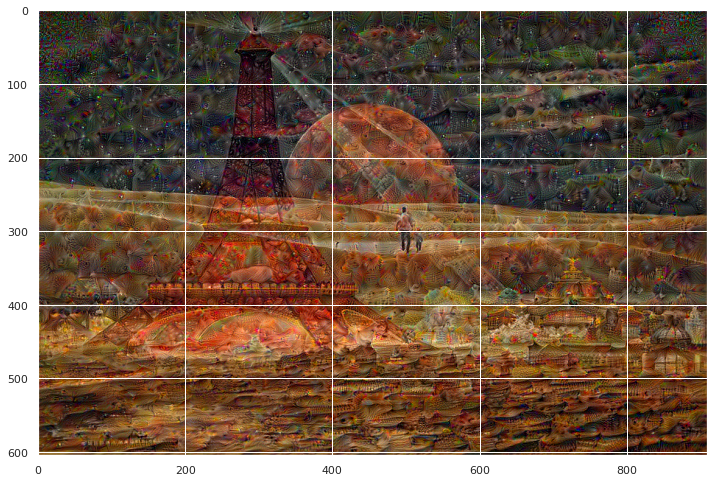

Step 1500, loss 2.257089614868164


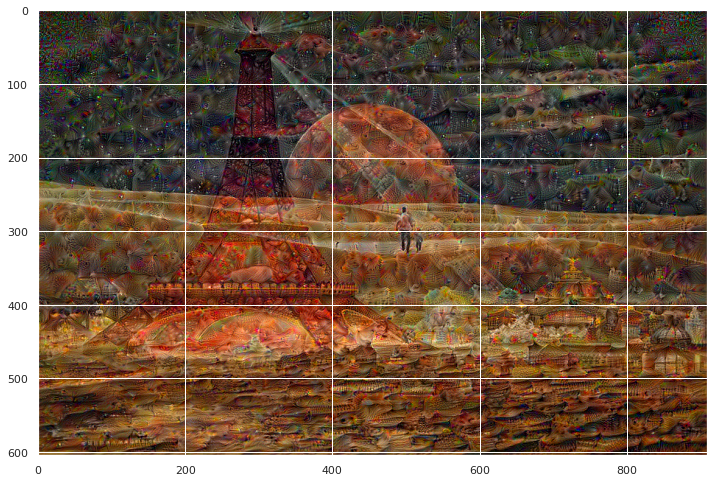

Step 1600, loss 2.285068988800049


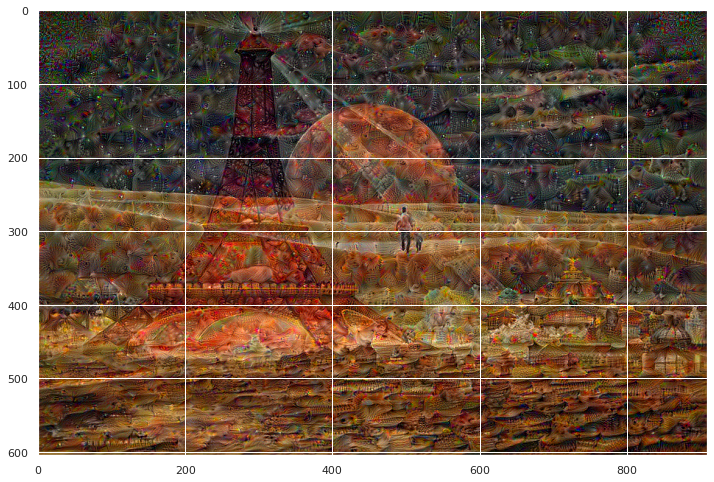

Step 1700, loss 2.3115968704223633


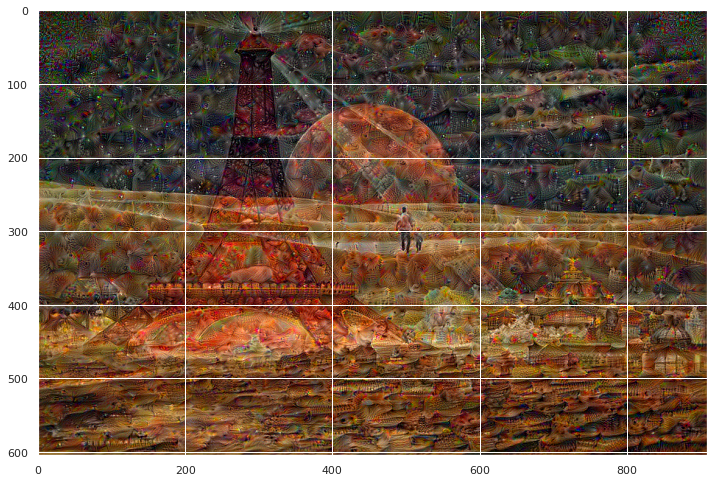

Step 1800, loss 2.3374133110046387


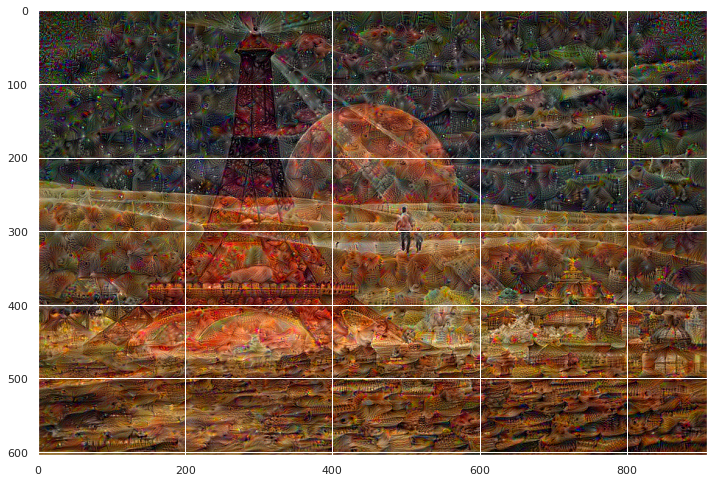

Step 1900, loss 2.36118483543396


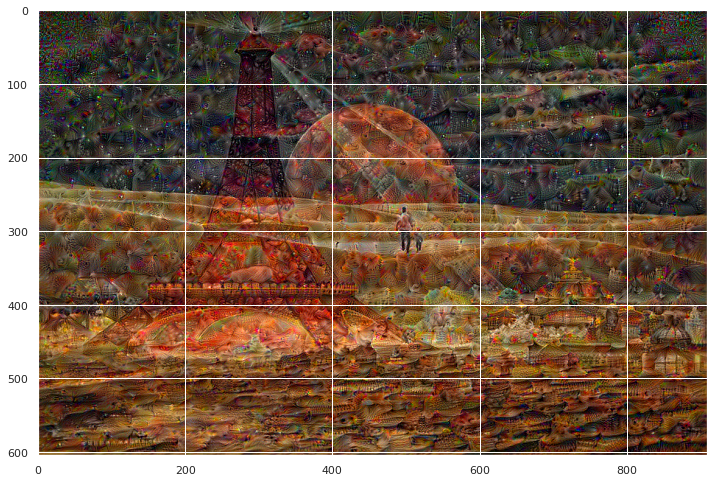

Step 2000, loss 2.384261131286621


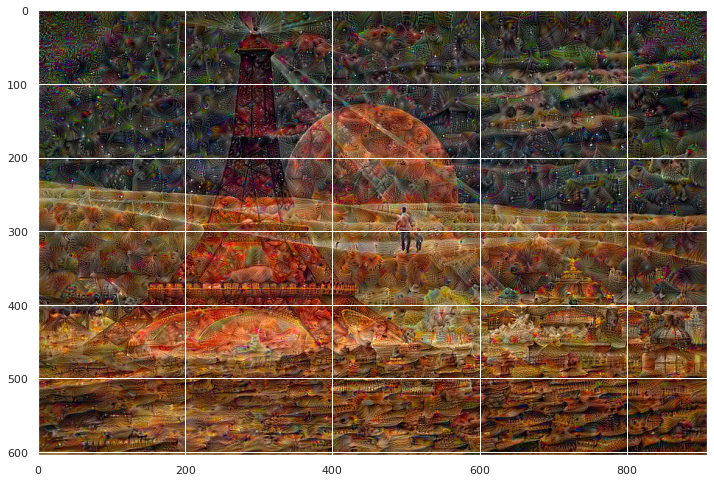

Step 2100, loss 2.4063379764556885


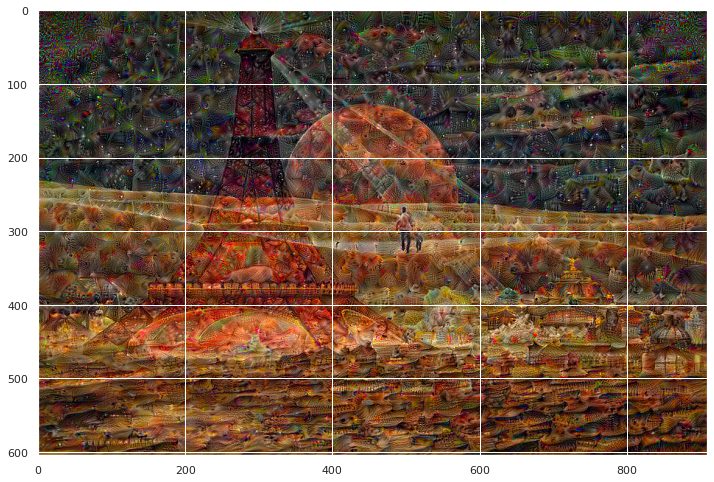

Step 2200, loss 2.4273905754089355


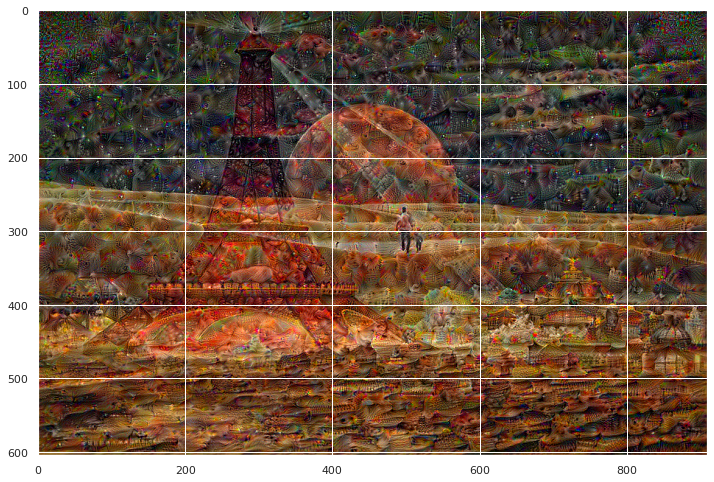

Step 2300, loss 2.447659492492676


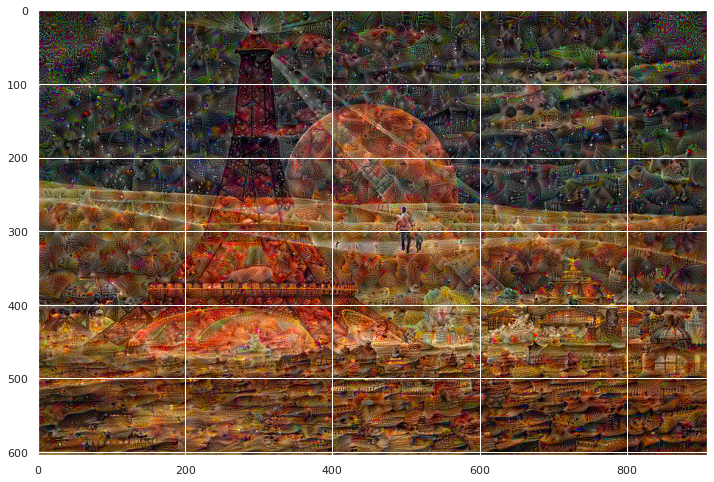

Step 2400, loss 2.4678523540496826


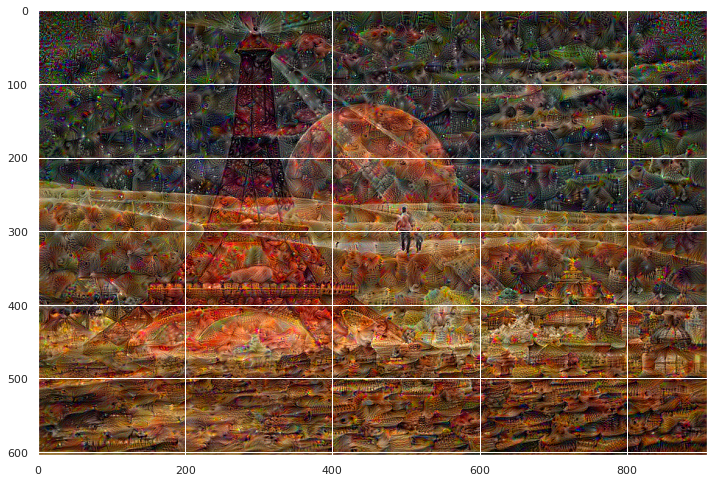

Step 2500, loss 2.4870386123657227


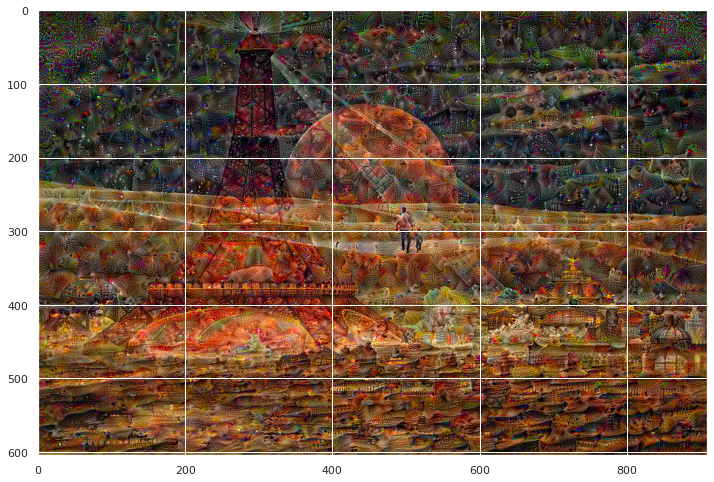

Step 2600, loss 2.5054807662963867


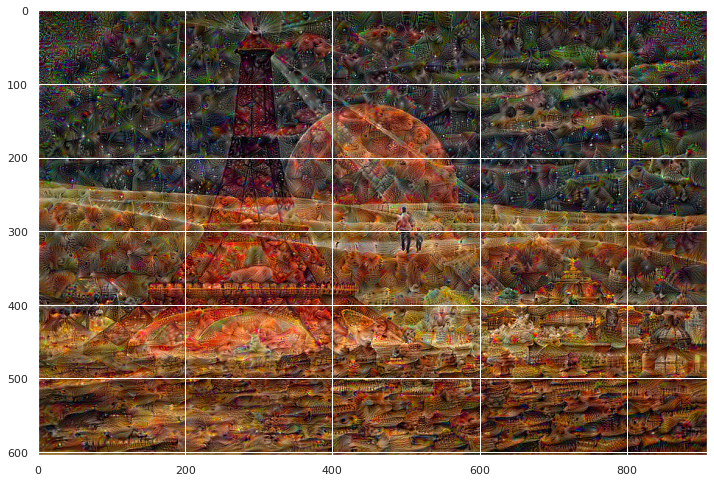

Step 2700, loss 2.5238232612609863


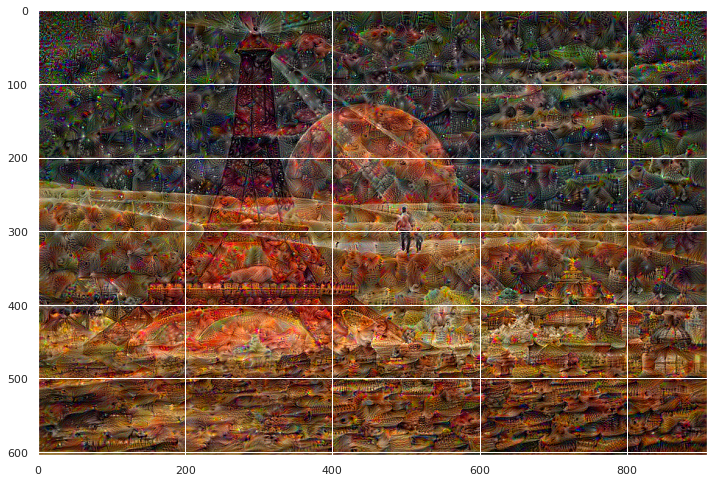

Step 2800, loss 2.541627883911133


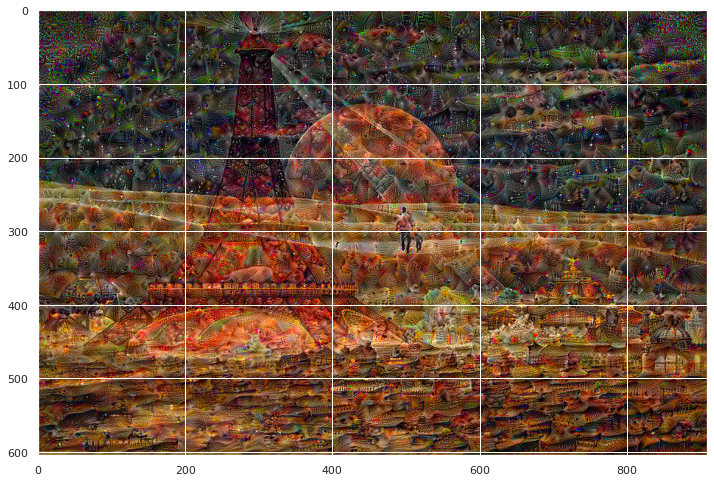

Step 2900, loss 2.558560371398926


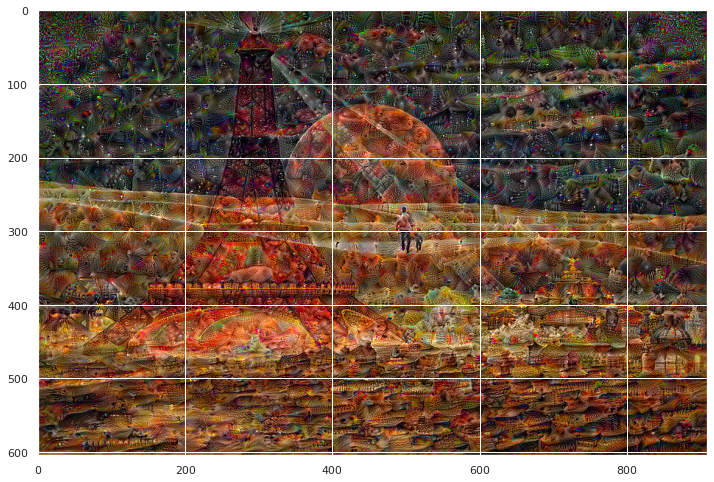

Step 3000, loss 2.5756335258483887


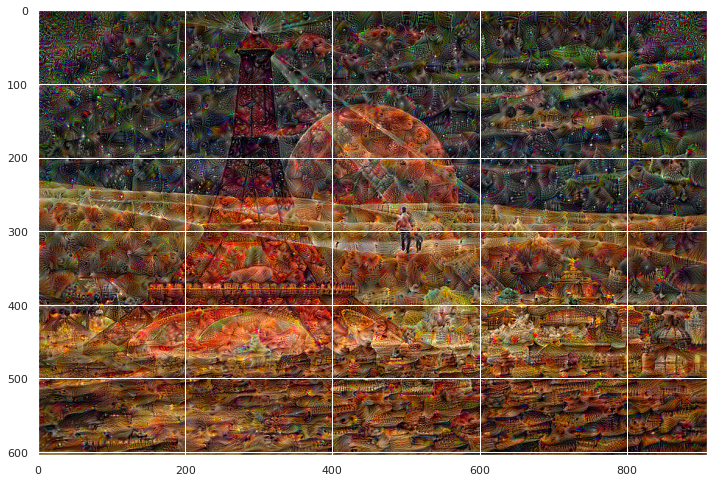

Step 3100, loss 2.591869592666626


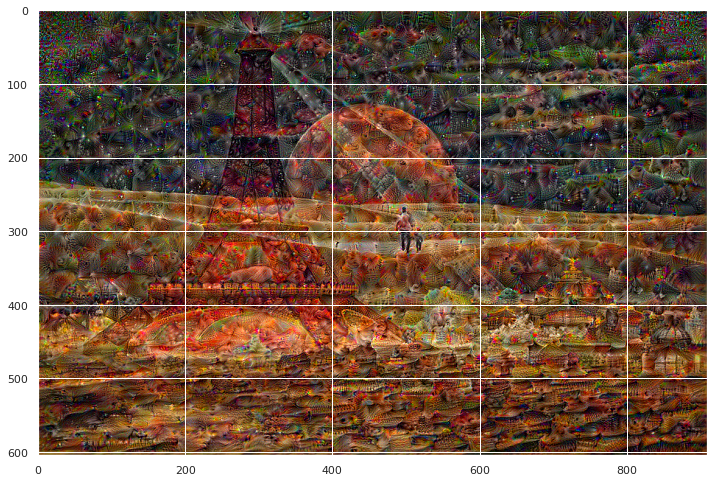

Step 3200, loss 2.607769012451172


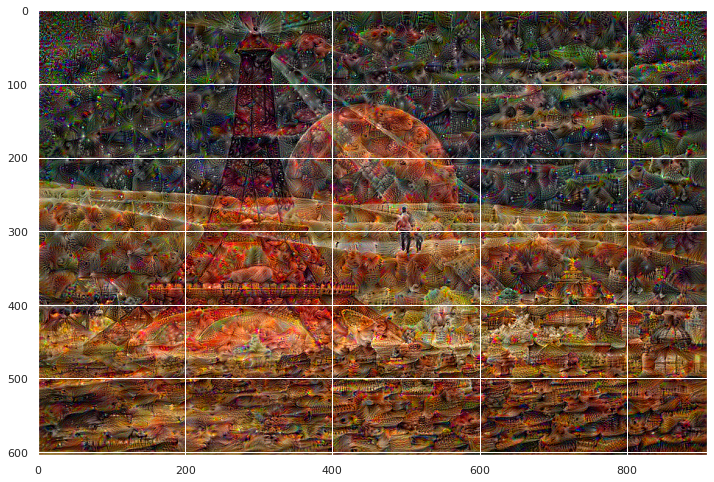

Step 3300, loss 2.6234421730041504


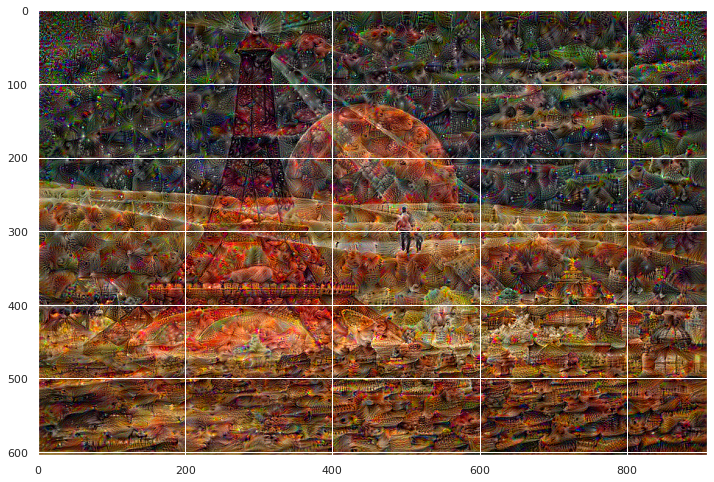

Step 3400, loss 2.6386399269104004


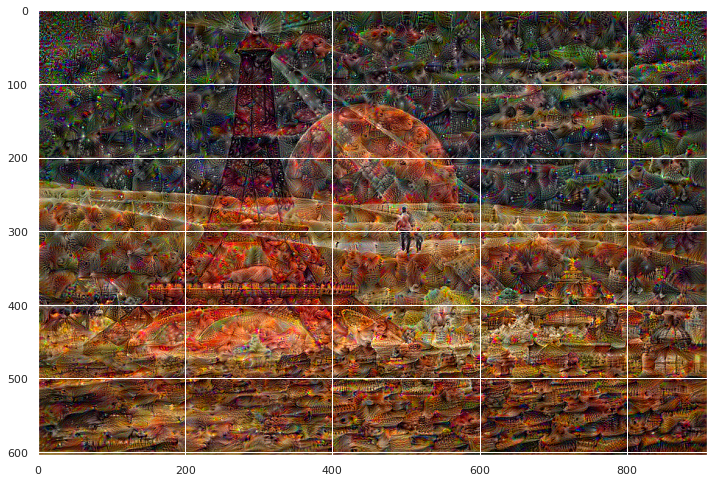

Step 3500, loss 2.653054714202881


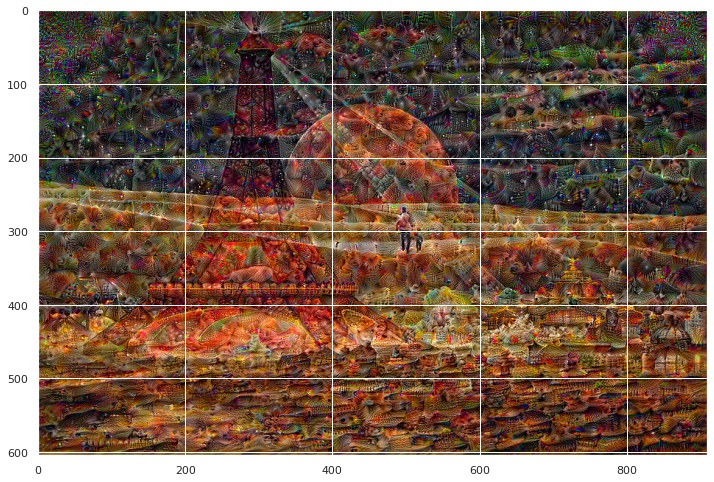

Step 3600, loss 2.667419910430908


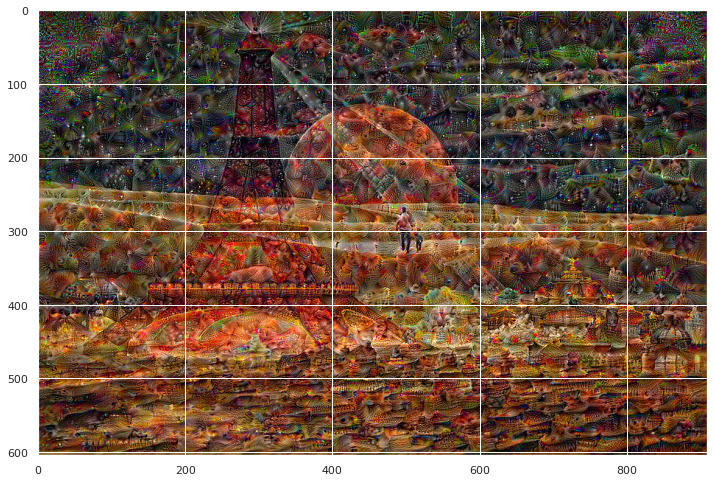

Step 3700, loss 2.681540012359619


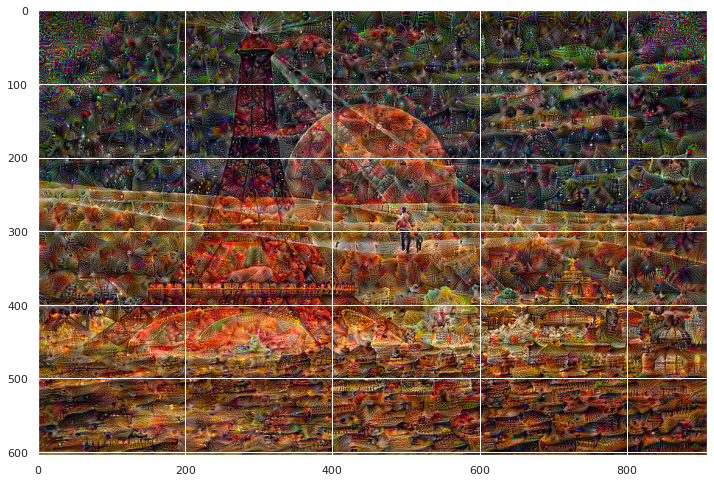

Step 3800, loss 2.69547963142395


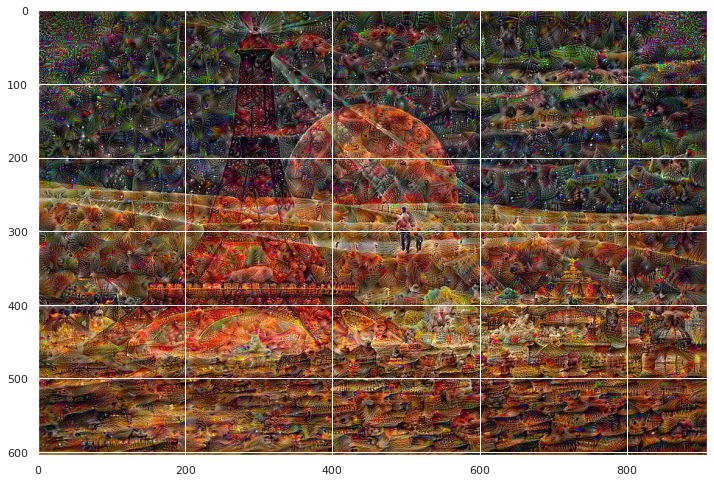

Step 3900, loss 2.709003448486328


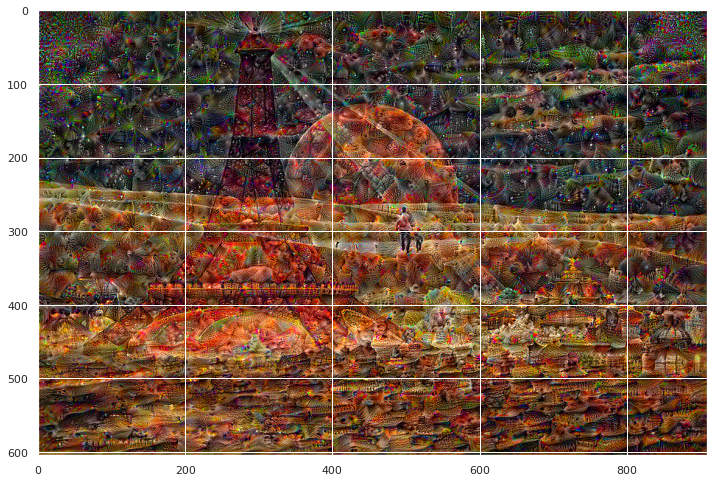

In [ ]:
samp_img = np.array(tf.keras.preprocessing.image.load_img('ImageBlend.jpg'))
dream_img = run_deep_dream(model = deepdrm_model,image= samp_img, steps = 4000, step_size= 0.001)

Applying DeepDream to generate a series of image

In [ ]:
img = np.array(tf.keras.preprocessing.image.load_img('ImageBlend.jpg'))

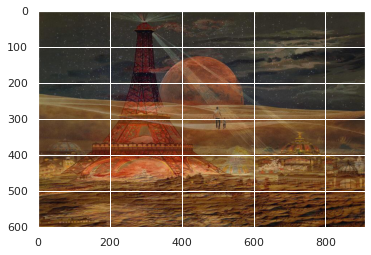

In [ ]:
plt.imshow(img)

In [ ]:
dream_name = 'mars_eiffel'

In [ ]:
x_size = 910
y_size = 605

In [ ]:
created_count = 0
max_count = 50

In [ ]:
def load_images(filename):
  img = PIL.Image.open(filename)
  return np.float32(img)

In [ ]:
import os

In [ ]:
for i in range(0, 50):
     
    if os.path.isfile('/content/drive/My Drive/Creative AI Dataset/{}/img_{}.jpg'.format(dream_name, i+1)):
        print("{} present already, continue fetching the frames...".format(i+1))
        
    else:
        img_result = load_image(r'/content/drive/My Drive/Creative AI Dataset/{}/img_{}.jpg'.format(dream_name, i))

    
        x_zoom = 2
        y_zoom = 1
        
        img_result = img_result[0+x_zoom : y_size-y_zoom, 0+y_zoom : x_size-x_zoom]
        img_result = cv2.resize(img_result, (x_size, y_size))
        
        img_result[:, :, 0] += 2  
        img_result[:, :, 1] += 2  
        img_result[:, :, 2] += 2  
        
        
        img_result = run_deep_dream(model = deepdrm_model, image = img_result, steps = 500, step_size = 0.001)
        
        img_result = np.clip(img_result, 0.0, 255.0)
        img_result = img_result.astype(np.uint8)
        result = PIL.Image.fromarray(img_result, mode='RGB')
        
        result.save(r'/content/drive/My Drive/Creative AI Dataset/{}/img_{}.jpg'.format(dream_name, i+1))
        
        created_count += 1
        if created_count > max_count:
            break

1 present already, continue fetching the frames...
2 present already, continue fetching the frames...
3 present already, continue fetching the frames...
4 present already, continue fetching the frames...
5 present already, continue fetching the frames...
6 present already, continue fetching the frames...
7 present already, continue fetching the frames...
8 present already, continue fetching the frames...
9 present already, continue fetching the frames...
10 present already, continue fetching the frames...
11 present already, continue fetching the frames...
12 present already, continue fetching the frames...
13 present already, continue fetching the frames...
14 present already, continue fetching the frames...
15 present already, continue fetching the frames...
16 present already, continue fetching the frames...
17 present already, continue fetching the frames...
18 present already, continue fetching the frames...
19 present already, continue fetching the frames...
20 present already, c

Create a video from all the frames

In [ ]:
from google.colab import files
upload = files.upload()

Saving mars_eiffel.zip.zip to mars_eiffel.zip.zip


In [ ]:
from zipfile import ZipFile
file_name = 'mars_eiffel.zip.zip'

with ZipFile(file_name, 'r') as zip:
  zip.extractall()
  print('Done')

Done


In [ ]:
dream_path = '/content/drive/My Drive/Creative AI Dataset/mars_eiffel'

In [ ]:
fourcc = cv2.VideoWriter_fourcc(*'XVID')

out = cv2.VideoWriter('deepdreamvideo.avi', fourcc, 5.0, (910, 605))

In [ ]:
for i in range(99999):
  if os.path.isfile('/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_{}.jpg'.format(i+1)):
    pass
  else:
    dream_length = i
    break

In [ ]:
dream_length

200

In [ ]:
for i in range(dream_length):
  img_path = os.path.join(dream_path, 'img_{}.jpg'.format(i))

  print(img_path)

  frame = cv2.imread(img_path)
  out.write(frame)

out.release()

/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_0.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_1.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_2.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_3.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_4.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_5.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_6.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_7.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_8.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_9.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_10.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_11.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_12.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_13.jpg
/content/drive/My Drive/Creative AI Dataset/mars_eiffel/img_14.jpg
/cont